In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.ensemble import IsolationForest
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder

%matplotlib inline

columns = ["duration",
           "protocol_type",
           "service",
           "flag",
           "src_bytes",
           "dst_bytes",
           "land",
           "wrong_fragment",
           "urgent",
           "hot",
           "num_failed_logins",
           "logged_in",
           "num_compromised",
           "root_shell",
           "su_attempted",
           "num_root",
           "num_file_creations",
           "num_shells",
           "num_access_files",
           "num_outbound_cmds",
           "is_host_login",
           "is_guest_login",
           "count",
           "srv_count",
           "serror_rate",
           "srv_serror_rate",
           "rerror_rate",
           "srv_rerror_rate",
           "same_srv_rate",
           "diff_srv_rate",
           "srv_diff_host_rate",
           "dst_host_count",
           "dst_host_srv_count",
           "dst_home_same_srv_rate",
           "dst_host_diff_srv_rate",
           "dst_host_same_src_port_rate",
           "dst_host_srv_diff_host_rate",
           "dst_host_serror_rate",
           "dst_host_srv_serror_rate",
           "dst_host_rerror_rate",
           "dst_host_srv_rerror_rate",
           "label"]

In [2]:
df = pd.read_csv("/Users/shawnmccarthy/Desktop/Independent Study/IsolationForest/data/kddcup.data", sep=",", names=columns, index_col=None)
df.shape

(4898431, 42)

In [3]:
#clean up the data
df = df[df["service"] == "http"]
df = df.drop("service", axis=1)
columns.remove("service")
df.shape

(623091, 41)

In [4]:
df["label"].value_counts()
df.head(5)

for col in df.columns:
    if df[col].dtype == "object":
        encoded = LabelEncoder()
        encoded.fit(df[col])
        df[col] = encoded.transform(df[col])

df.head(5)

,duration,protocol_type,flag,src_bytes,dst_bytes,land,wrong_fragment,urgent,hot,num_failed_logins,...,dst_host_srv_count,dst_home_same_srv_rate,dst_host_diff_srv_rate,dst_host_same_src_port_rate,dst_host_srv_diff_host_rate,dst_host_serror_rate,dst_host_srv_serror_rate,dst_host_rerror_rate,dst_host_srv_rerror_rate,label
0,0,0,9,215,45076,0,0,0,0,0,...,0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,4
1,0,0,9,162,4528,0,0,0,0,0,...,1,1.0,0.0,1.00,0.0,0.0,0.0,0.0,0.0,4
2,0,0,9,236,1228,0,0,0,0,0,...,2,1.0,0.0,0.50,0.0,0.0,0.0,0.0,0.0,4
3,0,0,9,233,2032,0,0,0,0,0,...,3,1.0,0.0,0.33,0.0,0.0,0.0,0.0,0.0,4
4,0,0,9,239,486,0,0,0,0,0,...,4,1.0,0.0,0.25,0.0,0.0,0.0,0.0,0.0,4


In [5]:
for f in range(0, 3) :
    df = df.iloc[np.random.permutation(len(df))]

df2 = df[:500000]
labels = df2["label"];

df_validate = df[500000:]

x_train, x_test, y_train, y_test = train_test_split(df2, labels, test_size=0.2, random_state=42)

x_val, y_val = df_validate, df_validate["label"];

In [6]:
print("Shapes:\nx_train:%s\ny_train:%s\n" % (x_train.shape, y_train.shape))
print("x_test:%s\ny_test:%s\n" % (x_test.shape, y_test.shape))
print("x_val:%s\ny_val:%s\n" % (x_val.shape, y_val.shape))

Shapes:
x_train:(400000, 41)
y_train:(400000,)

x_test:(100000, 41)
y_test:(100000,)

x_val:(123091, 41)
y_val:(123091,)



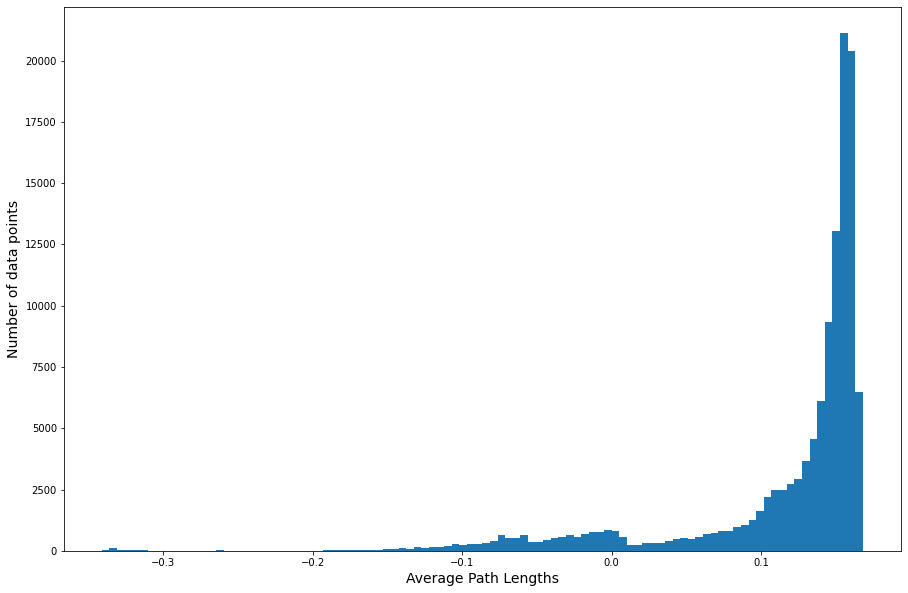

In [7]:
isolation_forest = IsolationForest(n_estimators=100, max_samples=256, contamination=0.1, random_state=42);
isolation_forest.fit(x_train)

anomaly_scores = isolation_forest.decision_function(x_val)
plt.figure(figsize=(15,10))
plt.hist(anomaly_scores, bins=100)
plt.xlabel('Average Path Lengths', fontsize=14)
plt.ylabel('Number of data points', fontsize=14)
plt.show()

AUC: 96.10%


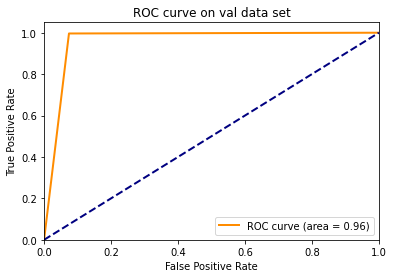

In [8]:
from sklearn.metrics import roc_auc_score, roc_curve

anomalies = anomaly_scores > -0.19
matches = y_val == list(encoded.classes_).index("normal.")
fpr, tpr, _ = roc_curve(anomalies, matches)
auc = roc_auc_score(anomalies, matches)
print ("AUC: {:.2%}".format(auc))

plt.plot(fpr, tpr, color='darkorange',
         lw=2, label='ROC curve (area = %0.2f)' % auc)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC curve on val data set')
plt.legend(loc="lower right")
plt.show()

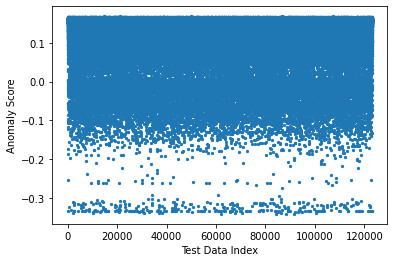

duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        1.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate                      1.00
srv_rerror_r

Name: 1404588, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        1.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate         

Name: 499598, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        1.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate          

Name: 66683, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             9.00
src_bytes                      281.00
dst_bytes                      764.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        1.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        2.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate           

Name: 3404584, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        2.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate         

Name: 1398782, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        2.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate         

Name: 1455765, dtype: float64
duration                           0.00
protocol_type                      0.00
flag                               9.00
src_bytes                      54540.00
dst_bytes                       8314.00
land                               0.00
wrong_fragment                     0.00
urgent                             0.00
hot                                2.00
num_failed_logins                  0.00
logged_in                          1.00
num_compromised                    1.00
root_shell                         0.00
su_attempted                       0.00
num_root                           0.00
num_file_creations                 0.00
num_shells                         0.00
num_access_files                   0.00
num_outbound_cmds                  0.00
is_host_login                      0.00
is_guest_login                     0.00
count                              4.00
srv_count                          5.00
serror_rate                        0.00
srv_serror

Name: 3679692, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        1.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate         

Name: 3405414, dtype: float64
duration                        0.00
protocol_type                   0.00
flag                            1.00
src_bytes                       0.00
dst_bytes                       0.00
land                            0.00
wrong_fragment                  0.00
urgent                          0.00
hot                             0.00
num_failed_logins               0.00
logged_in                       0.00
num_compromised                 0.00
root_shell                      0.00
su_attempted                    0.00
num_root                        0.00
num_file_creations              0.00
num_shells                      0.00
num_access_files                0.00
num_outbound_cmds               0.00
is_host_login                   0.00
is_guest_login                  0.00
count                           1.00
srv_count                       1.00
serror_rate                     0.00
srv_serror_rate                 0.00
rerror_rate                     1.00
srv_rerr

Name: 1411163, dtype: float64
duration                        0.00
protocol_type                   0.00
flag                            1.00
src_bytes                       0.00
dst_bytes                       0.00
land                            0.00
wrong_fragment                  0.00
urgent                          0.00
hot                             0.00
num_failed_logins               0.00
logged_in                       0.00
num_compromised                 0.00
root_shell                      0.00
su_attempted                    0.00
num_root                        0.00
num_file_creations              0.00
num_shells                      0.00
num_access_files                0.00
num_outbound_cmds               0.00
is_host_login                   0.00
is_guest_login                  0.00
count                           1.00
srv_count                       1.00
serror_rate                     0.00
srv_serror_rate                 0.00
rerror_rate                     1.00
srv_rerr

Name: 3424711, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        1.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate         

Name: 4764901, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        1.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate         

Name: 3929712, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        1.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate         

Name: 4516156, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        1.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate         

Name: 1390276, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        1.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate         

Name: 506321, dtype: float64
duration                          0.00
protocol_type                     0.00
flag                              9.00
src_bytes                       306.00
dst_bytes                      2239.00
land                              0.00
wrong_fragment                    0.00
urgent                            0.00
hot                               0.00
num_failed_logins                 0.00
logged_in                         1.00
num_compromised                   0.00
root_shell                        0.00
su_attempted                      0.00
num_root                          0.00
num_file_creations                0.00
num_shells                        0.00
num_access_files                  0.00
num_outbound_cmds                 0.00
is_host_login                     0.00
is_guest_login                    0.00
count                             6.00
srv_count                         8.00
serror_rate                       0.00
srv_serror_rate                   0

duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                          296.00
srv_count                       19.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate                      1.00
srv_rerror_r

Name: 510623, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        1.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate          

Name: 3404916, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        1.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate         

Name: 1456525, dtype: float64
duration                          0.00
protocol_type                     0.00
flag                              9.00
src_bytes                       318.00
dst_bytes                      2698.00
land                              0.00
wrong_fragment                    0.00
urgent                            0.00
hot                               0.00
num_failed_logins                 0.00
logged_in                         1.00
num_compromised                   0.00
root_shell                        0.00
su_attempted                      0.00
num_root                          0.00
num_file_creations                0.00
num_shells                        0.00
num_access_files                  1.00
num_outbound_cmds                 0.00
is_host_login                     0.00
is_guest_login                    0.00
count                            18.00
srv_count                        18.00
serror_rate                       0.00
srv_serror_rate                   

Name: 1456277, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        1.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate         

Name: 3681430, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        1.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate         

Name: 393367, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             9.00
src_bytes                      294.00
dst_bytes                      671.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        1.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            2.00
srv_count                        2.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate          

duration                         0.00
protocol_type                    0.00
flag                             5.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            5.00
srv_count                       10.00
serror_rate                      0.20
srv_serror_rate                  0.30
rerror_rate                      0.00
srv_rerror_r

Name: 730905, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        1.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate          

Name: 4515721, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        1.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate         

Name: 1456335, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        1.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate         

Name: 1443449, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        1.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate         

Name: 4512177, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        1.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate         

Name: 1396974, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        1.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate         

Name: 508182, dtype: float64
duration                       0.00
protocol_type                  0.00
flag                           1.00
src_bytes                      0.00
dst_bytes                      0.00
land                           0.00
wrong_fragment                 0.00
urgent                         0.00
hot                            0.00
num_failed_logins              0.00
logged_in                      0.00
num_compromised                0.00
root_shell                     0.00
su_attempted                   0.00
num_root                       0.00
num_file_creations             0.00
num_shells                     0.00
num_access_files               0.00
num_outbound_cmds              0.00
is_host_login                  0.00
is_guest_login                 0.00
count                          1.00
srv_count                      2.00
serror_rate                    0.00
srv_serror_rate                0.00
rerror_rate                    1.00
srv_rerror_rate                1.00

Name: 1455438, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            2.00
srv_count                        2.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate         

Name: 1391344, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        2.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate         

Name: 1443032, dtype: float64
duration                          0.00
protocol_type                     0.00
flag                              9.00
src_bytes                       234.00
dst_bytes                      4978.00
land                              0.00
wrong_fragment                    0.00
urgent                            0.00
hot                               0.00
num_failed_logins                 0.00
logged_in                         1.00
num_compromised                   0.00
root_shell                        0.00
su_attempted                      0.00
num_root                          0.00
num_file_creations                0.00
num_shells                        0.00
num_access_files                  0.00
num_outbound_cmds                 0.00
is_host_login                     0.00
is_guest_login                    0.00
count                            17.00
srv_count                        20.00
serror_rate                       0.00
srv_serror_rate                   

Name: 1403678, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        1.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate         

duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        2.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate                      1.00
srv_rerror_r

Name: 3680327, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        2.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate         

Name: 403055, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             9.00
src_bytes                      225.00
dst_bytes                      680.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        1.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                           36.00
srv_count                       55.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate          

Name: 3405994, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        1.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate         

Name: 732579, dtype: float64
duration                        0.00
protocol_type                   0.00
flag                            1.00
src_bytes                       0.00
dst_bytes                       0.00
land                            0.00
wrong_fragment                  0.00
urgent                          0.00
hot                             0.00
num_failed_logins               0.00
logged_in                       0.00
num_compromised                 0.00
root_shell                      0.00
su_attempted                    0.00
num_root                        0.00
num_file_creations              0.00
num_shells                      0.00
num_access_files                0.00
num_outbound_cmds               0.00
is_host_login                   0.00
is_guest_login                  0.00
count                           2.00
srv_count                       2.00
serror_rate                     0.00
srv_serror_rate                 0.00
rerror_rate                     1.00
srv_rerro

Name: 4514261, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        2.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate         

Name: 1411447, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        1.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate         

Name: 3424279, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             5.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                          139.00
srv_count                       10.00
serror_rate                      1.00
srv_serror_rate                  1.00
rerror_rate         

Name: 417208, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        3.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate          

Name: 723981, dtype: float64
duration                          0.00
protocol_type                     0.00
flag                              9.00
src_bytes                       479.00
dst_bytes                      6839.00
land                              0.00
wrong_fragment                    0.00
urgent                            0.00
hot                               0.00
num_failed_logins                 0.00
logged_in                         1.00
num_compromised                   0.00
root_shell                        0.00
su_attempted                      0.00
num_root                          0.00
num_file_creations                0.00
num_shells                        0.00
num_access_files                  0.00
num_outbound_cmds                 0.00
is_host_login                     0.00
is_guest_login                    0.00
count                             8.00
srv_count                         8.00
serror_rate                       0.00
srv_serror_rate                   0

Name: 4546017, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        1.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate         

Name: 414328, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        1.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate          

duration                           0.00
protocol_type                      0.00
flag                               9.00
src_bytes                      54540.00
dst_bytes                       8314.00
land                               0.00
wrong_fragment                     0.00
urgent                             0.00
hot                                2.00
num_failed_logins                  0.00
logged_in                          1.00
num_compromised                    1.00
root_shell                         0.00
su_attempted                       0.00
num_root                           0.00
num_file_creations                 0.00
num_shells                         0.00
num_access_files                   0.00
num_outbound_cmds                  0.00
is_host_login                      0.00
is_guest_login                     0.00
count                              1.00
srv_count                          1.00
serror_rate                        0.00
srv_serror_rate                    0.00


Name: 893980, dtype: float64
duration                          0.00
protocol_type                     0.00
flag                              9.00
src_bytes                       240.00
dst_bytes                      2912.00
land                              0.00
wrong_fragment                    0.00
urgent                            0.00
hot                               0.00
num_failed_logins                 0.00
logged_in                         1.00
num_compromised                   0.00
root_shell                        0.00
su_attempted                      0.00
num_root                          0.00
num_file_creations                0.00
num_shells                        0.00
num_access_files                  0.00
num_outbound_cmds                 0.00
is_host_login                     0.00
is_guest_login                    0.00
count                            16.00
srv_count                        16.00
serror_rate                       0.06
srv_serror_rate                   0

Name: 1455531, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        1.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate         

duration                        0.00
protocol_type                   0.00
flag                            1.00
src_bytes                       0.00
dst_bytes                       0.00
land                            0.00
wrong_fragment                  0.00
urgent                          0.00
hot                             0.00
num_failed_logins               0.00
logged_in                       0.00
num_compromised                 0.00
root_shell                      0.00
su_attempted                    0.00
num_root                        0.00
num_file_creations              0.00
num_shells                      0.00
num_access_files                0.00
num_outbound_cmds               0.00
is_host_login                   0.00
is_guest_login                  0.00
count                           1.00
srv_count                       2.00
serror_rate                     0.00
srv_serror_rate                 0.00
rerror_rate                     1.00
srv_rerror_rate                 1.00
s

Name: 1390063, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        1.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate         

Name: 1399168, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        2.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate         

Name: 1409880, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        1.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate         

Name: 402824, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        1.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate          

Name: 3679732, dtype: float64
duration                           0.00
protocol_type                      0.00
flag                               9.00
src_bytes                      54540.00
dst_bytes                       8314.00
land                               0.00
wrong_fragment                     0.00
urgent                             0.00
hot                                2.00
num_failed_logins                  0.00
logged_in                          1.00
num_compromised                    1.00
root_shell                         0.00
su_attempted                       0.00
num_root                           0.00
num_file_creations                 0.00
num_shells                         0.00
num_access_files                   0.00
num_outbound_cmds                  0.00
is_host_login                      0.00
is_guest_login                     0.00
count                              3.00
srv_count                          3.00
serror_rate                        0.00
srv_serror

Name: 1440952, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             9.00
src_bytes                      334.00
dst_bytes                      293.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        1.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            3.00
srv_count                        3.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate         

Name: 404392, dtype: float64
duration                         0.0
protocol_type                    0.0
flag                             1.0
src_bytes                        0.0
dst_bytes                        0.0
land                             0.0
wrong_fragment                   0.0
urgent                           0.0
hot                              0.0
num_failed_logins                0.0
logged_in                        0.0
num_compromised                  0.0
root_shell                       0.0
su_attempted                     0.0
num_root                         0.0
num_file_creations               0.0
num_shells                       0.0
num_access_files                 0.0
num_outbound_cmds                0.0
is_host_login                    0.0
is_guest_login                   0.0
count                            1.0
srv_count                        1.0
serror_rate                      0.0
srv_serror_rate                  0.0
rerror_rate                      1.0
srv_rerro

Name: 1391288, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        5.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate         

duration                        0.00
protocol_type                   0.00
flag                            1.00
src_bytes                       0.00
dst_bytes                       0.00
land                            0.00
wrong_fragment                  0.00
urgent                          0.00
hot                             0.00
num_failed_logins               0.00
logged_in                       0.00
num_compromised                 0.00
root_shell                      0.00
su_attempted                    0.00
num_root                        0.00
num_file_creations              0.00
num_shells                      0.00
num_access_files                0.00
num_outbound_cmds               0.00
is_host_login                   0.00
is_guest_login                  0.00
count                           1.00
srv_count                       1.00
serror_rate                     0.00
srv_serror_rate                 0.00
rerror_rate                     1.00
srv_rerror_rate                 1.00
s

duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        1.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate                      1.00
srv_rerror_r

Name: 1344219, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        1.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate         

Name: 3426451, dtype: float64
duration                        0.00
protocol_type                   0.00
flag                            1.00
src_bytes                       0.00
dst_bytes                       0.00
land                            0.00
wrong_fragment                  0.00
urgent                          0.00
hot                             0.00
num_failed_logins               0.00
logged_in                       0.00
num_compromised                 0.00
root_shell                      0.00
su_attempted                    0.00
num_root                        0.00
num_file_creations              0.00
num_shells                      0.00
num_access_files                0.00
num_outbound_cmds               0.00
is_host_login                   0.00
is_guest_login                  0.00
count                           1.00
srv_count                       1.00
serror_rate                     0.00
srv_serror_rate                 0.00
rerror_rate                     1.00
srv_rerr

Name: 417592, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        1.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate          

Name: 1442961, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        1.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate         

duration                        0.00
protocol_type                   0.00
flag                            1.00
src_bytes                       0.00
dst_bytes                       0.00
land                            0.00
wrong_fragment                  0.00
urgent                          0.00
hot                             0.00
num_failed_logins               0.00
logged_in                       0.00
num_compromised                 0.00
root_shell                      0.00
su_attempted                    0.00
num_root                        0.00
num_file_creations              0.00
num_shells                      0.00
num_access_files                0.00
num_outbound_cmds               0.00
is_host_login                   0.00
is_guest_login                  0.00
count                           1.00
srv_count                       3.00
serror_rate                     0.00
srv_serror_rate                 0.00
rerror_rate                     1.00
srv_rerror_rate                 1.00
s

Name: 1444364, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        1.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate         

Name: 3424501, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        2.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate         

Name: 1410633, dtype: float64
duration                        0.0
protocol_type                   0.0
flag                            1.0
src_bytes                       0.0
dst_bytes                       0.0
land                            0.0
wrong_fragment                  0.0
urgent                          0.0
hot                             0.0
num_failed_logins               0.0
logged_in                       0.0
num_compromised                 0.0
root_shell                      0.0
su_attempted                    0.0
num_root                        0.0
num_file_creations              0.0
num_shells                      0.0
num_access_files                0.0
num_outbound_cmds               0.0
is_host_login                   0.0
is_guest_login                  0.0
count                           1.0
srv_count                       1.0
serror_rate                     0.0
srv_serror_rate                 0.0
rerror_rate                     1.0
srv_rerror_rate                 1.

Name: 729725, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        1.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate          

Name: 1398576, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        1.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate         

Name: 1412039, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        1.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate         

Name: 4548385, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        2.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate         

Name: 513628, dtype: float64
duration                          0.00
protocol_type                     0.00
flag                              9.00
src_bytes                       325.00
dst_bytes                      4002.00
land                              0.00
wrong_fragment                    0.00
urgent                            0.00
hot                               0.00
num_failed_logins                 0.00
logged_in                         1.00
num_compromised                   0.00
root_shell                        0.00
su_attempted                      0.00
num_root                          0.00
num_file_creations                0.00
num_shells                        0.00
num_access_files                  0.00
num_outbound_cmds                 0.00
is_host_login                     0.00
is_guest_login                    0.00
count                            18.00
srv_count                        18.00
serror_rate                       0.06
srv_serror_rate                   0

Name: 3407602, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        2.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate         

Name: 513001, dtype: float64
duration                          0.00
protocol_type                     0.00
flag                              9.00
src_bytes                       193.00
dst_bytes                      1478.00
land                              0.00
wrong_fragment                    0.00
urgent                            0.00
hot                               0.00
num_failed_logins                 0.00
logged_in                         1.00
num_compromised                   0.00
root_shell                        0.00
su_attempted                      0.00
num_root                          0.00
num_file_creations                0.00
num_shells                        0.00
num_access_files                  0.00
num_outbound_cmds                 0.00
is_host_login                     0.00
is_guest_login                    0.00
count                             1.00
srv_count                         6.00
serror_rate                       0.00
srv_serror_rate                   0

Name: 4515772, dtype: float64
duration                       177.00
protocol_type                    0.00
flag                             9.00
src_bytes                      232.00
dst_bytes                      260.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        1.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            8.00
srv_count                        8.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate         

Name: 1408835, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        2.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate         

Name: 4515649, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        1.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate         

Name: 3455747, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        1.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate         

Name: 1410211, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        1.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate         

Name: 1461879, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        1.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate         

Name: 4764935, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        2.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate         

Name: 417725, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        4.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate          

Name: 160544, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        1.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate          

duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        1.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate                      1.00
srv_rerror_r

Name: 512370, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        1.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate          

Name: 396356, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        3.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate          

Name: 722980, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        1.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate          

Name: 1379038, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        1.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate         

Name: 3406395, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        1.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate         

Name: 4479748, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        2.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate         

Name: 1409871, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        1.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate         

Name: 1443704, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        2.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate         

duration                       152.00
protocol_type                    0.00
flag                             9.00
src_bytes                      326.00
dst_bytes                      188.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        1.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        4.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate                      0.00
srv_rerror_r

Name: 1458008, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        1.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate         

Name: 396174, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        1.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate          

duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                           17.00
srv_count                       17.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate                      0.76
srv_rerror_r

Name: 4516108, dtype: float64
duration                           0.00
protocol_type                      0.00
flag                               9.00
src_bytes                      54540.00
dst_bytes                       8314.00
land                               0.00
wrong_fragment                     0.00
urgent                             0.00
hot                                2.00
num_failed_logins                  0.00
logged_in                          1.00
num_compromised                    1.00
root_shell                         0.00
su_attempted                       0.00
num_root                           0.00
num_file_creations                 0.00
num_shells                         0.00
num_access_files                   0.00
num_outbound_cmds                  0.00
is_host_login                      0.00
is_guest_login                     0.00
count                              6.00
srv_count                          6.00
serror_rate                        0.00
srv_serror

Name: 1460584, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        1.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate         

Name: 3457314, dtype: float64
duration                        0.00
protocol_type                   0.00
flag                            1.00
src_bytes                       0.00
dst_bytes                       0.00
land                            0.00
wrong_fragment                  0.00
urgent                          0.00
hot                             0.00
num_failed_logins               0.00
logged_in                       0.00
num_compromised                 0.00
root_shell                      0.00
su_attempted                    0.00
num_root                        0.00
num_file_creations              0.00
num_shells                      0.00
num_access_files                0.00
num_outbound_cmds               0.00
is_host_login                   0.00
is_guest_login                  0.00
count                           1.00
srv_count                       1.00
serror_rate                     0.00
srv_serror_rate                 0.00
rerror_rate                     1.00
srv_rerr

Name: 1398223, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        1.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate         

Name: 4480107, dtype: float64
duration                          0.00
protocol_type                     0.00
flag                              9.00
src_bytes                       266.00
dst_bytes                      2424.00
land                              0.00
wrong_fragment                    0.00
urgent                            0.00
hot                               0.00
num_failed_logins                 0.00
logged_in                         1.00
num_compromised                   0.00
root_shell                        0.00
su_attempted                      0.00
num_root                          0.00
num_file_creations                0.00
num_shells                        0.00
num_access_files                  0.00
num_outbound_cmds                 0.00
is_host_login                     0.00
is_guest_login                    0.00
count                             1.00
srv_count                         1.00
serror_rate                       0.00
srv_serror_rate                   

duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        1.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate                      1.00
srv_rerror_r

Name: 401764, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        1.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate          

duration                        0.00
protocol_type                   0.00
flag                            1.00
src_bytes                       0.00
dst_bytes                       0.00
land                            0.00
wrong_fragment                  0.00
urgent                          0.00
hot                             0.00
num_failed_logins               0.00
logged_in                       0.00
num_compromised                 0.00
root_shell                      0.00
su_attempted                    0.00
num_root                        0.00
num_file_creations              0.00
num_shells                      0.00
num_access_files                0.00
num_outbound_cmds               0.00
is_host_login                   0.00
is_guest_login                  0.00
count                           1.00
srv_count                       3.00
serror_rate                     0.00
srv_serror_rate                 0.00
rerror_rate                     1.00
srv_rerror_rate                 1.00
s

Name: 3405191, dtype: float64
duration                          0.00
protocol_type                     0.00
flag                              9.00
src_bytes                       308.00
dst_bytes                      2698.00
land                              0.00
wrong_fragment                    0.00
urgent                            0.00
hot                               0.00
num_failed_logins                 0.00
logged_in                         1.00
num_compromised                   0.00
root_shell                        0.00
su_attempted                      0.00
num_root                          0.00
num_file_creations                0.00
num_shells                        0.00
num_access_files                  1.00
num_outbound_cmds                 0.00
is_host_login                     0.00
is_guest_login                    0.00
count                             3.00
srv_count                        11.00
serror_rate                       0.00
srv_serror_rate                   

Name: 1460711, dtype: float64
duration                           0.00
protocol_type                      0.00
flag                               9.00
src_bytes                      54540.00
dst_bytes                       8314.00
land                               0.00
wrong_fragment                     0.00
urgent                             0.00
hot                                2.00
num_failed_logins                  0.00
logged_in                          1.00
num_compromised                    1.00
root_shell                         0.00
su_attempted                       0.00
num_root                           0.00
num_file_creations                 0.00
num_shells                         0.00
num_access_files                   0.00
num_outbound_cmds                  0.00
is_host_login                      0.00
is_guest_login                     0.00
count                              1.00
srv_count                          2.00
serror_rate                        0.00
srv_serror

Name: 416342, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        1.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate          

duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        1.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate                      1.00
srv_rerror_r

Name: 3456090, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        1.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate         

Name: 1399255, dtype: float64
duration                          0.00
protocol_type                     0.00
flag                              9.00
src_bytes                       308.00
dst_bytes                      2698.00
land                              0.00
wrong_fragment                    0.00
urgent                            0.00
hot                               0.00
num_failed_logins                 0.00
logged_in                         1.00
num_compromised                   0.00
root_shell                        0.00
su_attempted                      0.00
num_root                          0.00
num_file_creations                0.00
num_shells                        0.00
num_access_files                  1.00
num_outbound_cmds                 0.00
is_host_login                     0.00
is_guest_login                    0.00
count                             6.00
srv_count                         7.00
serror_rate                       0.00
srv_serror_rate                   

Name: 752424, dtype: float64
duration                         0.0
protocol_type                    0.0
flag                             1.0
src_bytes                        0.0
dst_bytes                        0.0
land                             0.0
wrong_fragment                   0.0
urgent                           0.0
hot                              0.0
num_failed_logins                0.0
logged_in                        0.0
num_compromised                  0.0
root_shell                       0.0
su_attempted                     0.0
num_root                         0.0
num_file_creations               0.0
num_shells                       0.0
num_access_files                 0.0
num_outbound_cmds                0.0
is_host_login                    0.0
is_guest_login                   0.0
count                            1.0
srv_count                        1.0
serror_rate                      0.0
srv_serror_rate                  0.0
rerror_rate                      1.0
srv_rerro

duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        1.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate                      1.00
srv_rerror_r

Name: 3425418, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        2.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate         

Name: 511737, dtype: float64
duration                          0.00
protocol_type                     0.00
flag                              9.00
src_bytes                       308.00
dst_bytes                      2698.00
land                              0.00
wrong_fragment                    0.00
urgent                            0.00
hot                               0.00
num_failed_logins                 0.00
logged_in                         1.00
num_compromised                   0.00
root_shell                        0.00
su_attempted                      0.00
num_root                          0.00
num_file_creations                0.00
num_shells                        0.00
num_access_files                  1.00
num_outbound_cmds                 0.00
is_host_login                     0.00
is_guest_login                    0.00
count                             4.00
srv_count                         4.00
serror_rate                       0.00
srv_serror_rate                   0

Name: 399982, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        1.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate          

Name: 417984, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        2.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate          

Name: 506438, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        1.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate          

Name: 729040, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        1.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate          

Name: 4764787, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        1.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate         

Name: 1409465, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        2.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate         

Name: 3425422, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        1.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate         

Name: 1457745, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             8.00
src_bytes                      344.00
dst_bytes                      201.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        1.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            5.00
srv_count                       11.00
serror_rate                      0.20
srv_serror_rate                  0.18
rerror_rate         

duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        1.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate                      1.00
srv_rerror_r

Name: 1455925, dtype: float64
duration                           0.00
protocol_type                      0.00
flag                               9.00
src_bytes                      54540.00
dst_bytes                       8314.00
land                               0.00
wrong_fragment                     0.00
urgent                             0.00
hot                                2.00
num_failed_logins                  0.00
logged_in                          1.00
num_compromised                    1.00
root_shell                         0.00
su_attempted                       0.00
num_root                           0.00
num_file_creations                 0.00
num_shells                         0.00
num_access_files                   0.00
num_outbound_cmds                  0.00
is_host_login                      0.00
is_guest_login                     0.00
count                              3.00
srv_count                          3.00
serror_rate                        0.00
srv_serror

Name: 3405413, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        1.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate         

Name: 403444, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             9.00
src_bytes                      233.00
dst_bytes                      261.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        1.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            8.00
srv_count                        8.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate          

Name: 3420144, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        1.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate         

Name: 402219, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        2.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate          

Name: 723914, dtype: float64
duration                           0.00
protocol_type                      0.00
flag                               9.00
src_bytes                      54540.00
dst_bytes                       8314.00
land                               0.00
wrong_fragment                     0.00
urgent                             0.00
hot                                2.00
num_failed_logins                  0.00
logged_in                          1.00
num_compromised                    1.00
root_shell                         0.00
su_attempted                       0.00
num_root                           0.00
num_file_creations                 0.00
num_shells                         0.00
num_access_files                   0.00
num_outbound_cmds                  0.00
is_host_login                      0.00
is_guest_login                     0.00
count                              6.00
srv_count                          6.00
serror_rate                        0.00
srv_serror_

duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        1.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate                      1.00
srv_rerror_r

Name: 1391268, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        1.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate         

Name: 414354, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        1.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate          

Name: 1441039, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        1.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate         

Name: 1442105, dtype: float64
duration                           0.00
protocol_type                      0.00
flag                               9.00
src_bytes                      54540.00
dst_bytes                       8314.00
land                               0.00
wrong_fragment                     0.00
urgent                             0.00
hot                                2.00
num_failed_logins                  0.00
logged_in                          1.00
num_compromised                    1.00
root_shell                         0.00
su_attempted                       0.00
num_root                           0.00
num_file_creations                 0.00
num_shells                         0.00
num_access_files                   0.00
num_outbound_cmds                  0.00
is_host_login                      0.00
is_guest_login                     0.00
count                              3.00
srv_count                          3.00
serror_rate                        0.00
srv_serror

Name: 3403737, dtype: float64
duration                        0.00
protocol_type                   0.00
flag                            1.00
src_bytes                       0.00
dst_bytes                       0.00
land                            0.00
wrong_fragment                  0.00
urgent                          0.00
hot                             0.00
num_failed_logins               0.00
logged_in                       0.00
num_compromised                 0.00
root_shell                      0.00
su_attempted                    0.00
num_root                        0.00
num_file_creations              0.00
num_shells                      0.00
num_access_files                0.00
num_outbound_cmds               0.00
is_host_login                   0.00
is_guest_login                  0.00
count                           1.00
srv_count                       1.00
serror_rate                     0.00
srv_serror_rate                 0.00
rerror_rate                     1.00
srv_rerr

Name: 1456629, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        1.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate         

Name: 1455491, dtype: float64
duration                          0.00
protocol_type                     0.00
flag                              9.00
src_bytes                       350.00
dst_bytes                      9725.00
land                              0.00
wrong_fragment                    0.00
urgent                            0.00
hot                               0.00
num_failed_logins                 0.00
logged_in                         1.00
num_compromised                   0.00
root_shell                        0.00
su_attempted                      0.00
num_root                          0.00
num_file_creations                0.00
num_shells                        0.00
num_access_files                  0.00
num_outbound_cmds                 0.00
is_host_login                     0.00
is_guest_login                    0.00
count                             3.00
srv_count                         3.00
serror_rate                       0.33
srv_serror_rate                   

Name: 4482070, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        1.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate         

Name: 3427036, dtype: float64
duration                        0.0
protocol_type                   0.0
flag                            1.0
src_bytes                       0.0
dst_bytes                       0.0
land                            0.0
wrong_fragment                  0.0
urgent                          0.0
hot                             0.0
num_failed_logins               0.0
logged_in                       0.0
num_compromised                 0.0
root_shell                      0.0
su_attempted                    0.0
num_root                        0.0
num_file_creations              0.0
num_shells                      0.0
num_access_files                0.0
num_outbound_cmds               0.0
is_host_login                   0.0
is_guest_login                  0.0
count                           1.0
srv_count                       1.0
serror_rate                     0.0
srv_serror_rate                 0.0
rerror_rate                     1.0
srv_rerror_rate                 1.

Name: 1398714, dtype: float64
duration                           0.00
protocol_type                      0.00
flag                               9.00
src_bytes                        259.00
dst_bytes                      41412.00
land                               0.00
wrong_fragment                     0.00
urgent                             0.00
hot                                1.00
num_failed_logins                  0.00
logged_in                          1.00
num_compromised                    0.00
root_shell                         0.00
su_attempted                       0.00
num_root                           0.00
num_file_creations                 0.00
num_shells                         0.00
num_access_files                   0.00
num_outbound_cmds                  0.00
is_host_login                      0.00
is_guest_login                     0.00
count                              1.00
srv_count                          2.00
serror_rate                        0.00
srv_serror

Name: 1442913, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        1.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate         

Name: 401856, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        1.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate          

Name: 513643, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        2.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate          

duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        1.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate                      1.00
srv_rerror_r

Name: 1444548, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        1.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate         

duration                        0.00
protocol_type                   0.00
flag                            1.00
src_bytes                       0.00
dst_bytes                       0.00
land                            0.00
wrong_fragment                  0.00
urgent                          0.00
hot                             0.00
num_failed_logins               0.00
logged_in                       0.00
num_compromised                 0.00
root_shell                      0.00
su_attempted                    0.00
num_root                        0.00
num_file_creations              0.00
num_shells                      0.00
num_access_files                0.00
num_outbound_cmds               0.00
is_host_login                   0.00
is_guest_login                  0.00
count                           1.00
srv_count                       1.00
serror_rate                     0.00
srv_serror_rate                 0.00
rerror_rate                     1.00
srv_rerror_rate                 1.00
s

Name: 1456064, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        1.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate         

Name: 1398241, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        1.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate         

duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        1.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate                      1.00
srv_rerror_r

Name: 1455984, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        1.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate         

Name: 4516639, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        1.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate         

Name: 403966, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        3.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate          

Name: 1440147, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        1.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate         

Name: 511035, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        1.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate          

Name: 3414948, dtype: float64
duration                          0.00
protocol_type                     0.00
flag                              9.00
src_bytes                       303.00
dst_bytes                      2239.00
land                              0.00
wrong_fragment                    0.00
urgent                            0.00
hot                               0.00
num_failed_logins                 0.00
logged_in                         1.00
num_compromised                   0.00
root_shell                        0.00
su_attempted                      0.00
num_root                          0.00
num_file_creations                0.00
num_shells                        0.00
num_access_files                  0.00
num_outbound_cmds                 0.00
is_host_login                     0.00
is_guest_login                    0.00
count                             5.00
srv_count                         5.00
serror_rate                       0.00
srv_serror_rate                   

Name: 726941, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        1.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate          

Name: 3680310, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        1.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate         

Name: 811034, dtype: float64
duration                          0.00
protocol_type                     0.00
flag                              9.00
src_bytes                       328.00
dst_bytes                      4408.00
land                              0.00
wrong_fragment                    0.00
urgent                            0.00
hot                               0.00
num_failed_logins                 0.00
logged_in                         1.00
num_compromised                   0.00
root_shell                        0.00
su_attempted                      0.00
num_root                          0.00
num_file_creations                0.00
num_shells                        0.00
num_access_files                  0.00
num_outbound_cmds                 0.00
is_host_login                     0.00
is_guest_login                    0.00
count                             2.00
srv_count                         5.00
serror_rate                       0.00
srv_serror_rate                   0

duration                          0.00
protocol_type                     0.00
flag                              9.00
src_bytes                       309.00
dst_bytes                      2698.00
land                              0.00
wrong_fragment                    0.00
urgent                            0.00
hot                               0.00
num_failed_logins                 0.00
logged_in                         1.00
num_compromised                   0.00
root_shell                        0.00
su_attempted                      0.00
num_root                          0.00
num_file_creations                0.00
num_shells                        0.00
num_access_files                  1.00
num_outbound_cmds                 0.00
is_host_login                     0.00
is_guest_login                    0.00
count                             6.00
srv_count                         6.00
serror_rate                       0.00
srv_serror_rate                   0.00
rerror_rate              

Name: 3404934, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        1.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate         

Name: 510684, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        1.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate          

duration                       0.00
protocol_type                  0.00
flag                           1.00
src_bytes                      0.00
dst_bytes                      0.00
land                           0.00
wrong_fragment                 0.00
urgent                         0.00
hot                            0.00
num_failed_logins              0.00
logged_in                      0.00
num_compromised                0.00
root_shell                     0.00
su_attempted                   0.00
num_root                       0.00
num_file_creations             0.00
num_shells                     0.00
num_access_files               0.00
num_outbound_cmds              0.00
is_host_login                  0.00
is_guest_login                 0.00
count                          1.00
srv_count                      1.00
serror_rate                    0.00
srv_serror_rate                0.00
rerror_rate                    1.00
srv_rerror_rate                1.00
same_srv_rate               

Name: 403551, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        1.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate          

duration                        0.00
protocol_type                   0.00
flag                            1.00
src_bytes                       0.00
dst_bytes                       0.00
land                            0.00
wrong_fragment                  0.00
urgent                          0.00
hot                             0.00
num_failed_logins               0.00
logged_in                       0.00
num_compromised                 0.00
root_shell                      0.00
su_attempted                    0.00
num_root                        0.00
num_file_creations              0.00
num_shells                      0.00
num_access_files                0.00
num_outbound_cmds               0.00
is_host_login                   0.00
is_guest_login                  0.00
count                           1.00
srv_count                       1.00
serror_rate                     0.00
srv_serror_rate                 0.00
rerror_rate                     1.00
srv_rerror_rate                 1.00
s

Name: 3444201, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        1.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate         

Name: 1346102, dtype: float64
duration                        0.00
protocol_type                   0.00
flag                            1.00
src_bytes                       0.00
dst_bytes                       0.00
land                            0.00
wrong_fragment                  0.00
urgent                          0.00
hot                             0.00
num_failed_logins               0.00
logged_in                       0.00
num_compromised                 0.00
root_shell                      0.00
su_attempted                    0.00
num_root                        0.00
num_file_creations              0.00
num_shells                      0.00
num_access_files                0.00
num_outbound_cmds               0.00
is_host_login                   0.00
is_guest_login                  0.00
count                           1.00
srv_count                       2.00
serror_rate                     0.00
srv_serror_rate                 0.00
rerror_rate                     1.00
srv_rerr

Name: 414555, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        1.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate          

Name: 730037, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        1.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate          

duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        1.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate                      1.00
srv_rerror_r

Name: 1455635, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        2.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate         

Name: 501046, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        1.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate          

Name: 751539, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        1.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate          

Name: 731547, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        1.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate          

Name: 1457762, dtype: float64
duration                        0.00
protocol_type                   0.00
flag                            1.00
src_bytes                       0.00
dst_bytes                       0.00
land                            0.00
wrong_fragment                  0.00
urgent                          0.00
hot                             0.00
num_failed_logins               0.00
logged_in                       0.00
num_compromised                 0.00
root_shell                      0.00
su_attempted                    0.00
num_root                        0.00
num_file_creations              0.00
num_shells                      0.00
num_access_files                0.00
num_outbound_cmds               0.00
is_host_login                   0.00
is_guest_login                  0.00
count                           1.00
srv_count                       1.00
serror_rate                     0.00
srv_serror_rate                 0.00
rerror_rate                     1.00
srv_rerr

Name: 4549268, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             9.00
src_bytes                      249.00
dst_bytes                      272.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        1.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        1.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate         

duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        1.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate                      1.00
srv_rerror_r

Name: 4479913, dtype: float64
duration                          0.00
protocol_type                     0.00
flag                              9.00
src_bytes                       181.00
dst_bytes                      1724.00
land                              0.00
wrong_fragment                    0.00
urgent                            0.00
hot                               0.00
num_failed_logins                 0.00
logged_in                         1.00
num_compromised                   0.00
root_shell                        0.00
su_attempted                      0.00
num_root                          0.00
num_file_creations                0.00
num_shells                        0.00
num_access_files                  0.00
num_outbound_cmds                 0.00
is_host_login                     0.00
is_guest_login                    0.00
count                             3.00
srv_count                         3.00
serror_rate                       0.00
srv_serror_rate                   

Name: 4516448, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        1.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate         

Name: 798630, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        1.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate          

Name: 1189008, dtype: float64
duration                       0.00
protocol_type                  0.00
flag                           1.00
src_bytes                      0.00
dst_bytes                      0.00
land                           0.00
wrong_fragment                 0.00
urgent                         0.00
hot                            0.00
num_failed_logins              0.00
logged_in                      0.00
num_compromised                0.00
root_shell                     0.00
su_attempted                   0.00
num_root                       0.00
num_file_creations             0.00
num_shells                     0.00
num_access_files               0.00
num_outbound_cmds              0.00
is_host_login                  0.00
is_guest_login                 0.00
count                          1.00
srv_count                      1.00
serror_rate                    0.00
srv_serror_rate                0.00
rerror_rate                    1.00
srv_rerror_rate                1.0

Name: 4516171, dtype: float64
duration                         0.00
protocol_type                    0.00
flag                             1.00
src_bytes                        0.00
dst_bytes                        0.00
land                             0.00
wrong_fragment                   0.00
urgent                           0.00
hot                              0.00
num_failed_logins                0.00
logged_in                        0.00
num_compromised                  0.00
root_shell                       0.00
su_attempted                     0.00
num_root                         0.00
num_file_creations               0.00
num_shells                       0.00
num_access_files                 0.00
num_outbound_cmds                0.00
is_host_login                    0.00
is_guest_login                   0.00
count                            1.00
srv_count                        8.00
serror_rate                      0.00
srv_serror_rate                  0.00
rerror_rate         

In [9]:
plt.ylabel('Anomaly Score')
plt.xlabel('Test Data Index')
plt.scatter(list(range(len(anomaly_scores))), anomaly_scores, s=5)

plt.show()

prediction = isolation_forest.predict(x_val)
#anomaly_data = [x_val[i] for i in range(len(x_val)) if prediction[i]==-1]
for i in range(len(x_val)):
    if prediction[i]==-1:
        print(x_val.iloc[i])

#print("%s  Anomalous records found out of a total %s" % (len(anomaly_data), len(x_train)))